In [1]:
%matplotlib inline
import pandas as pd
import matplotlib
import numpy as np
import matplotlib.cm as cm
import matplotlib.mlab as mlab
import matplotlib.pyplot as plt

#### create a random array of ints, drawn from {-1, 1}

In [420]:
def init_world(seed:int, length:int):
    np.random.seed(seed)
    iterable = (np.random.choice(2) * 2 - 1 for i in range(length))
    return np.fromiter(iterable, np.int16)

#### get the spatial correlation

In [421]:
def array_corr(data:np.ndarray, dist:int):
    span = len(data)
    curDex = 0
    tot = 0
    while curDex < span:
        tot += data[curDex] * data[(curDex + dist + span) % span]
        curDex += 1
    return tot

In [471]:
def array_corr_map(data:np.ndarray, max_corr_dist:int):
    row_count = len(data)
    corr_map = [[array_corr(data[0], i) for i in range(max_corr_dist)]]
    currow = 1
    while currow < row_count:
        curCorr = [array_corr(data[currow], i) for i in range(max_corr_dist)]
        corr_map = np.concatenate((corr_map, [curCorr]), axis=0)
        currow += 1
    return corr_map

In [477]:
def chunk_array(data:np.ndarray, chunk_sz:int):
    for i in range(0, len(data), chunk_sz):
        yield data[i:i + chunk_sz]

In [531]:
def chunk_array_avg(data:np.ndarray, chunk_sz:int):
    return [np.mean(i) for i in chunk_array(data, chunk_sz)]

In [542]:
def chunk_array_avg_series(data2d:np.ndarray, chunk_sz:int):
    row_count = len(data2d)
    chunks2d = [chunk_array_avg(data2d[0], chunk_sz)]
    currow = 1
    while currow < row_count:
        curRecord = [chunk_array_avg(data2d[currow], chunk_sz)]
        chunks2d = np.concatenate((chunks2d, curRecord), axis=0)
        currow += 1
    return chunks2d

#### arty is the logistic activation function, mapping R -> (0,1)

In [424]:
def arty(beta:float, h:float):
    return 1 - 1 / (1 + np.exp(h * beta))

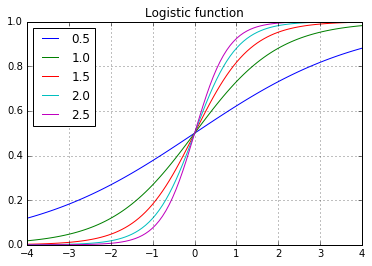

In [425]:
domain = np.linspace(-4, 4, 100)
plt.plot(domain, arty(0.5, domain), label='0.5')
plt.plot(domain, arty(1.0, domain), label='1.0')
plt.plot(domain, arty(1.5, domain), label='1.5')
plt.plot(domain, arty(2.0, domain), label='2.0')
plt.plot(domain, arty(2.5, domain), label='2.5')
plt.grid(True)
plt.legend(loc='upper left')
plt.title('Logistic function')
plt.show()

In [426]:
worlds = {}

In [427]:
# plt.figure(figsize=(5,6))
plt.rcParams["figure.figsize"]
# [6.0, 4.0]

[6.0, 4.0]

In [428]:
def plot_ca(world:np.ndarray):
    cmap = plt.get_cmap('RdBu')
    plt.figure(figsize=(60, 300))
    plt.imshow(world, interpolation='none', cmap=cmap)

In [429]:
gens = 10000
span = 4000
alpha = 0.4
beta = 0.75
seed = 333

In [430]:
worlds[0] = init_world(seed, span)

In [431]:
len(worlds[0])

4000

In [432]:
def update_cell(data:np.ndarray, alpha:float, beta:float, pos:int):
    span = len(data)
    colm2 = (pos - 2 + span) % span
    colm1 = (pos - 1 + span) % span
    colp1 = (pos + 1 + span) % span
    colp2 = (pos + 2 + span) % span
    vm2 = data[colm2] * alpha
    vm1 = data[colm1]
    vcc = data[pos]
    vp1 = data[colp1]
    vp2 = data[colp2] * alpha
    h = vm2 + vm1 + vcc + vp1 + vp2
    draw = np.random.uniform(0, 1)
    rescaled = arty(beta, h)
    if draw < rescaled:
        return 1
    else:
        return -1

In [433]:
def update_world(data:np.ndarray, alpha:float, beta:float):
    iterable = (update_cell(data, alpha, beta, i) for i in range(len(data)))
    return np.fromiter(iterable, np.int16)

In [434]:
oldWorld = init_world(seed, span)
worlds = [oldWorld]
currow=1.0
while currow < gens:
    newWorld = update_world(oldWorld, alpha, beta)
    worlds = np.concatenate((worlds, [newWorld]), axis=0)
    oldWorld = newWorld
    beta = 0.84 + 0.155 * np.sin(currow / 500)
    currow += 1.0

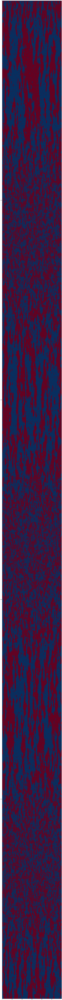

In [435]:
plot_ca(worlds[:,:600])

In [436]:
corr_map = array_corr_map(worlds)

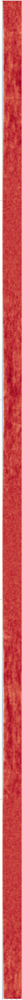

In [437]:
plot_ca(corr_map)

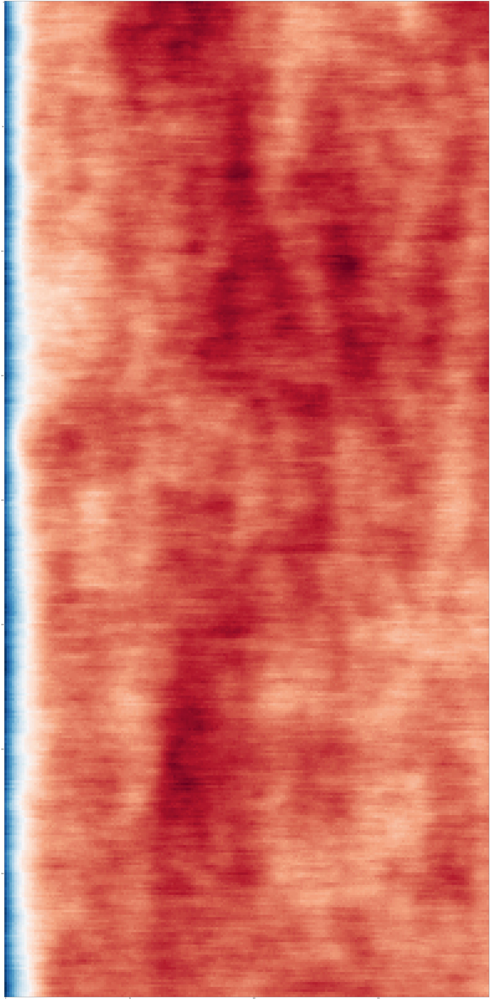

In [445]:
plot_ca(corr_map[3800:4200,5:])

In [447]:
np.save('worlds.npy', worlds)

In [448]:
np.save('corr_map.npy', corr_map)

In [450]:
import pandas as pd

In [468]:
cols = list(range(200))

In [461]:
dexy = pd.Index(0.84 + 0.155 * np.sin(currow / 500) for currow in range(10000))

In [463]:
worldsFrame = pd.DataFrame(worlds, index=dexy, columns=cols)

In [465]:
worldsFrame.to_csv("worldsFrame.csv")

In [467]:
len(corr_map[0])

200

In [469]:
corrFrame = pd.DataFrame(corr_map, index=dexy, columns=cols)

In [470]:
corrFrame.to_csv("corrFrame.csv")

In [544]:
chunkys = chunk_array_avg_series(worlds, 10)

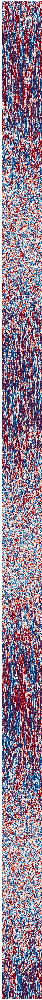

In [548]:
plot_ca(chunkys)

In [550]:
corr_map_chunks = array_corr_map(chunkys, 100)

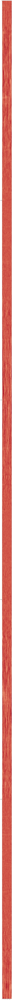

In [553]:
plot_ca(corr_map_chunks[1:, :])

In [4]:
def gruel():
    toss = np.random.random()
    if(toss < 0.01):
        return toss
    else:
        return 0

In [ ]:
from scipy import sparse
stride = 10000
# Let's build a 100 x 100 matrix with around 10% filled with ones
#A = abs((np.random.random(10000 ** 2) - 0.49)).round()
A = np.fromiter((gruel() for i in range(stride ** 2)), np.float64)
M = A.reshape(stride, stride)
S = sparse.csr_matrix(M)
S
# 100x100 sparse matrix of type '<type 'numpy.float64'>'
# 	with 980 stored elements in Compressed Sparse Row format>
# >>> %timeit S * S
#1000 loops, best of 3: 261 µs per loop

In [8]:
%timeit S * S

1000 loops, best of 3: 827 µs per loop


In [564]:
Q

<1000x1000 sparse matrix of type '<class 'numpy.float64'>'
	with 99984 stored elements in Compressed Sparse Row format>